# Understanding Diet, Habits, and Outer Factors in Diabetes and the Public's Health
Diabetes and obesity are growing problems in today's society. Unhealthy eating habits and inconsistent diets are creating an overall decline in people's general health. These behaviors can be traced back to multiple causes. The goal of this data research is to investigate the complex interplay between these causes. Using two complete and extensive datasets, we will examine the different correlations that can be made between the consumers’ diet, health and multiple outer factors, like income levels and food prices. Further numbers we will analyze include, for example, physical activity levels, addictions and education, to understand personal choices and health outcomes.

### Dataset 1:
The main dataset that we will be using for our project is called ‘Diabetes Health Indicators
Dataset’, derived from the Behavioural Risk Factor Surveillance System (BRFSS) which is
a yearly survey regarding health, published by the CDC. Our dataset is from the year
2015. It consists of answers from 253,680 individuals, including risk behaviours, health
issues, eating / drug habits, etc. The dataset is from a zip file containing three datasets
total, but our focus will be on “Diabetes_12”, which categorizes the presence of diabetes
into three classes. These numbers, in combination with the different variables from the
survey responses regarding health and diet, will help us draw out our datastory perfectly.
IN the code cell below the head of the dataset is printed.

**This dataset looks at the responsibility people take of eating fruits and vegetables.** This is al tied into the information regarding their income, education level and physical and mental health. Hence this is the dataset we will be exploring to support the view of people's responsibility, which could be linked to several factors.

In [71]:
import pandas as pd
import plotly.graph_objs as go
import plotly.express as px
import plotly.subplots as sp
import numpy as np
import string
import matplotlib.pyplot as plt

In [72]:
#df1: our first dataset.
df1 = pd.read_csv('diabetes_binary_health_indicators_BRFSS2015.csv')
df1.head(4)

,diabetes_binary,high_bp,high_chol,chol_check,bmi,smoker,stroke,heart_disease_or_attack,phys_activity,fruits,...,any_healthcare,no_docbc_cost,gen_hlth,ment_hlth,phys_hlth,diff_walk,sex,age,education,income
0,0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,...,1.0,0.0,5.0,18.0,15.0,1.0,0.0,9.0,4.0,3.0
1,0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,...,0.0,1.0,3.0,0.0,0.0,0.0,0.0,7.0,6.0,1.0
2,0.0,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,1.0,...,1.0,1.0,5.0,30.0,30.0,1.0,0.0,9.0,4.0,8.0
3,0.0,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,1.0,...,1.0,0.0,2.0,0.0,0.0,0.0,0.0,11.0,3.0,6.0


To use the dataset for a parallel categorial diagram of the bmi and food consumption some new columns have to be created


In [73]:
df1['bmi_qcut'] = pd.qcut(df1['bmi'], q=5, labels=False)
df1.head(4)

,diabetes_binary,high_bp,high_chol,chol_check,bmi,smoker,stroke,heart_disease_or_attack,phys_activity,fruits,...,no_docbc_cost,gen_hlth,ment_hlth,phys_hlth,diff_walk,sex,age,education,income,bmi_qcut
0,0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,...,0.0,5.0,18.0,15.0,1.0,0.0,9.0,4.0,3.0,4
1,0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,...,1.0,3.0,0.0,0.0,0.0,0.0,7.0,6.0,1.0,1
2,0.0,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,1.0,...,1.0,5.0,30.0,30.0,1.0,0.0,9.0,4.0,8.0,2
3,0.0,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,1.0,...,0.0,2.0,0.0,0.0,0.0,0.0,11.0,3.0,6.0,2


### Telling the story:
For us to sketch the way of looking at the data, we need to do some analysis on the data. we will also represent the variables we will be using, negating any other variables which will not be used.

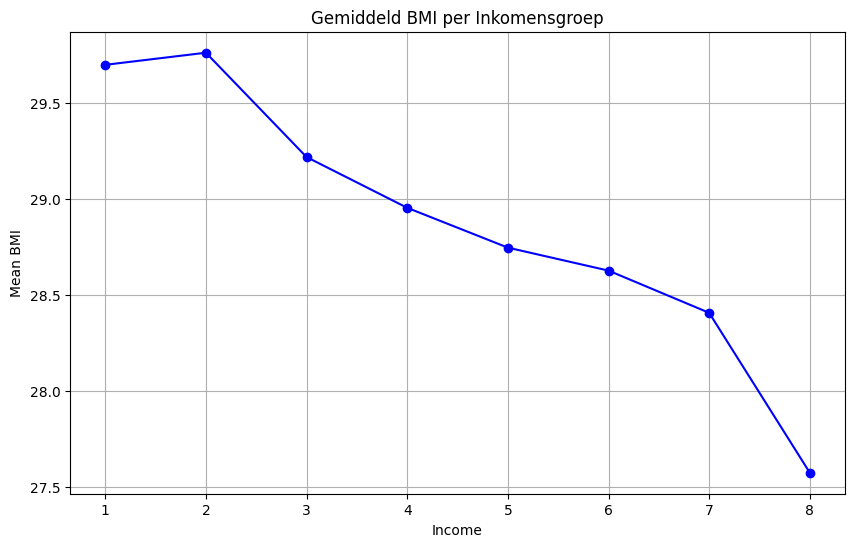

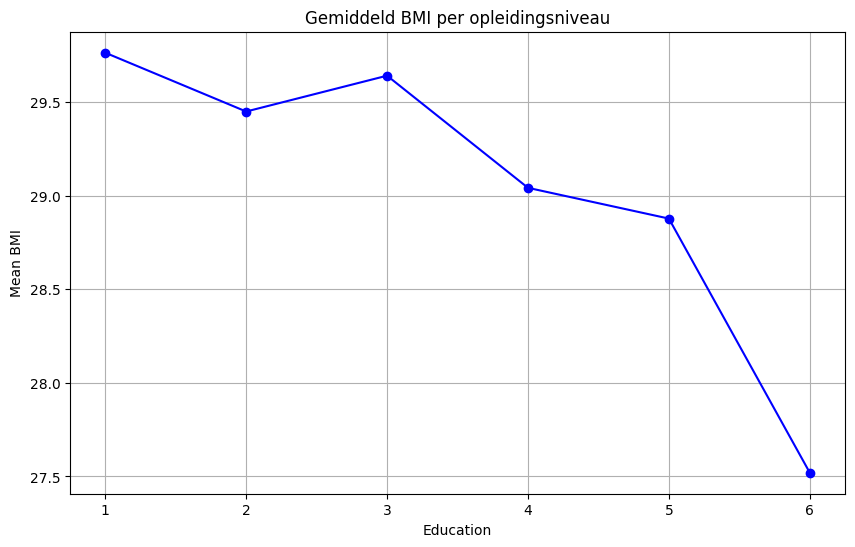

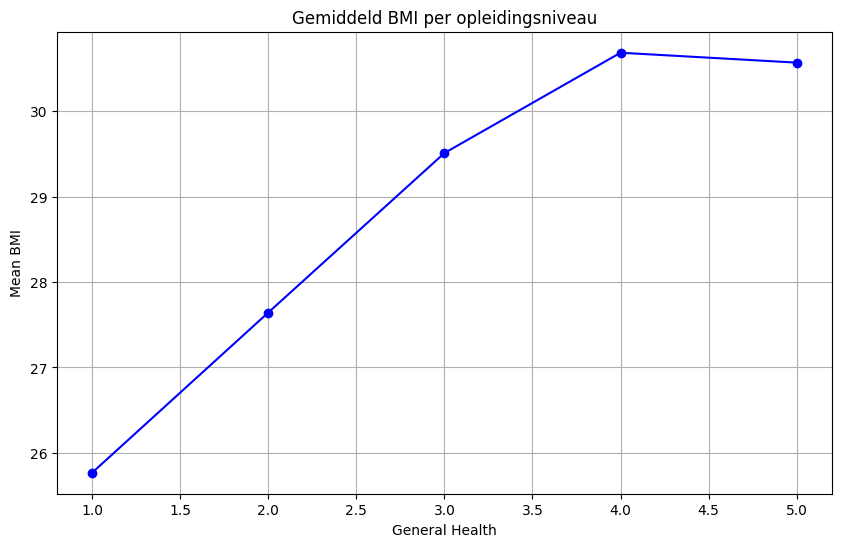

In [74]:
# graph bmi
fig = px.histogram(df1, x='bmi', title='BMI')
fig.show()

# graph income
fig = px.histogram(df1, x='income', title='Income')
fig.show()


# bmi vs income
# Bereken het gemiddelde bmi per inkomensgroep
mean_bmi_by_income = df1.groupby('income')['bmi'].mean()

plt.figure(figsize=(10, 6))
mean_bmi_by_income.plot(kind='line', marker='o', color='blue')
plt.xlabel('Income')
plt.ylabel('Mean BMI')
plt.title('Gemiddeld BMI per Inkomensgroep')
plt.grid(True)
plt.show()


# bmi vs education
# Bereken het gemiddelde bmi per inkomensgroep
mean_bmi_by_education = df1.groupby('education')['bmi'].mean()

plt.figure(figsize=(10, 6))
mean_bmi_by_education.plot(kind='line', marker='o', color='blue')
plt.xlabel('Education')
plt.ylabel('Mean BMI')
plt.title('Gemiddeld BMI per opleidingsniveau')
plt.grid(True)
plt.show()


# bmi vs general health
mean_bmi_by_GenHlth = df1.groupby('gen_hlth')['bmi'].mean()

plt.figure(figsize=(10, 6))
mean_bmi_by_GenHlth.plot(kind='line', marker='o', color='blue')
plt.xlabel('General Health')
plt.ylabel('Mean BMI')
plt.title('Gemiddeld BMI per opleidingsniveau')
plt.grid(True)
plt.show()

For reference of the populations health it is good to look at the BMI distrubution of a population, since this heavily effects ones health. For this we will distribute the BMI once again, but now looking at the amount of people that are in a certain weight group which is defined by Voedingscentrum.nl as: <br>
Lower than 18,5: Underweight <br>
From 18,5 to 25: Healthy weight <br>
From 25 to 30: Overweight <br>
30 and higher: Severe overweight (Obese)

In [75]:
cutoff=[0, 18.5, 25, 30, 999]
labels=['Underweight', 'Healthy weight', 'Overweight', 'Obese']
cut_bmi, cut_bmi_bins = pd.cut(df1['bmi'], bins=cutoff, labels=labels, retbins=True)
df1['cut_bmi'] = cut_bmi

fig2 = px.histogram(cut_bmi, x = cut_bmi)
fig2.update_layout(
    title = 'status of bmi in The US',
    xaxis = dict(title='cut_bmi'),
    width = 1072
)

bmi_counts = df1['cut_bmi'].value_counts()
# Calculate the percentage distribution
bmi_percentage = bmi_counts / len(df1) * 100

fig3 = px.pie(values=bmi_percentage, names=bmi_counts.index)
fig3.update_layout(
    title='Distribution of BMI Categories',
    width=1072
)

fig2.show()
fig3.show()

#Generative AI was used to aid the process of generating the code for fig3

Here we see that the distribution of The US its BMI is shifting towards a severe majority of overweight and obese citizens. This is a major problem, but how do we know what causes this and is it linked to the number of diabetes cases in the US. For this we will generate a parralel categorial diagram. To implement this as a visualization we first need to add a column to our dataframe which categorizes people based on their eating habits. These habits will include whether they consume fruits and vegetables each day and whether they partake in heavy alchohol consumption, which i defined as drinking more than 14 glasses of alchohol per week.

In [76]:
conditions = [
    (df1['fruits'] == 1) & (df1['veggies'] == 1) & (df1['hvy_alcohol_consump'] == 0),
    (df1['fruits'] == 1) & (df1['veggies'] == 1) & (df1['hvy_alcohol_consump'] == 1),
    (df1['fruits'] == 1) & (df1['veggies'] == 0) & (df1['hvy_alcohol_consump'] == 1),
    (df1['fruits'] == 1) & (df1['veggies'] == 0) & (df1['hvy_alcohol_consump'] == 0),
    (df1['fruits'] == 0) & (df1['veggies'] == 1) & (df1['hvy_alcohol_consump'] == 0),
    (df1['fruits'] == 0) & (df1['veggies'] == 1) & (df1['hvy_alcohol_consump'] == 1),
    (df1['fruits'] == 0) & (df1['veggies'] == 0) & (df1['hvy_alcohol_consump'] == 1),
    (df1['fruits'] == 0) & (df1['veggies'] == 0) & (df1['hvy_alcohol_consump'] == 0)
]

values = [
    'fruit+veggies+no_hvy_alcohol',
    'fruit+veggies+hvy_alcohol',
    'fruit+no_veggies+hvy_alcohol',
    'fruit+no_veggies+no_hvy_alcohol',
    'no_fruit+veggies+hvy_alcohol',
    'no_fruit+veggies+no_hvy_alcohol',
    'no_fruit+no_veggies+hvy_alcohol',
    'no_fruit+no_veggies+no_hvy_alcohol'
]

# Create the new column based on the conditions and values
df1['food_consumption'] = np.select(conditions, values, default=np.nan)
df1.head(2)

,diabetes_binary,high_bp,high_chol,chol_check,bmi,smoker,stroke,heart_disease_or_attack,phys_activity,fruits,...,ment_hlth,phys_hlth,diff_walk,sex,age,education,income,bmi_qcut,cut_bmi,food_consumption
0,0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,...,18.0,15.0,1.0,0.0,9.0,4.0,3.0,4,Obese,no_fruit+veggies+hvy_alcohol
1,0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,7.0,6.0,1.0,1,Healthy weight,no_fruit+no_veggies+no_hvy_alcohol


In [77]:
colors = {'Low': 'blue', 'Low-Medium': 'yellow', 'Medium': 'green', 'Medium-High': 'orange', 'High': 'red'}

fig5 = go.Figure(go.Parcats(
    dimensions=[
        {'label': 'BMI',
         'values': df1['cut_bmi']},
        {'label': 'Diabetes_binary',
         'values': df1['diabetes_binary']},
        {'label': 'High_blood_pressure_binary',
         'values': df1['high_bp']},
        {'label': 'High_cholesterol_binary',
         'values': df1['high_chol']},
        {'label': 'Food_consumption',
         'values': df1['food_consumption']}
    ],
    line={'color': df1['bmi_qcut'].map(colors)},
    labelfont={'size': 18},
    tickfont={'size': 16},
    arrangement='freeform'
))


fig5.update_layout(
    title = 'Analysis of health to food consumption',
    height = 600,
    width = 1072
)
"""


# Create the Parcats trace
parcats_trace = go.Figure(go.Parcats(
    dimensions=[df1['diabetes_binary'], df1['high_bp'], df1['high_chol'], df1['food_consumption'], bmi_dim],
    line={'color': df1['bmi'].map(colors)},
    labelfont={'size': 18, 'family': 'Times'},
    tickfont={'size': 16, 'family': 'Times'},
    arrangement='freeform'
))

"""
fig5.show()
#parcast_trace.show()

In [78]:
overlap_count = ((df1['diabetes_binary'] == 1) & (df1['smoker'] == 1)).sum()
amount_of_smokers = (df1['smoker'] == 1).sum()
amount_of_nonsmokers = (df1['smoker'] == 0).sum()
overlap_count_healthy = ((df1['fruits'] == 1) & (df1['smoker'] == 1) & (df1['veggies'] == 1)).sum()
overlap_count_unhealthy = ((df1['high_chol'] == 1) & (df1['smoker'] == 1)).sum()

overlap_count2 = ((df1['diabetes_binary'] == 1) & (df1['hvy_alcohol_consump'] == 1)).sum()
amount_of_drinkers = (df1['hvy_alcohol_consump'] == 1).sum()
amount_of_nondrinkers = (df1['hvy_alcohol_consump'] == 0).sum()
overlap_count_healthy2 = ((df1['fruits'] == 1) & (df1['hvy_alcohol_consump'] == 1) & (df1['veggies'] == 1)).sum()
overlap_count_unhealthy2 = ((df1['high_chol'] == 1) & (df1['hvy_alcohol_consump'] == 1)).sum()

column1_count = df1['diabetes_binary'].sum()
column2_count = df1['fruits'].sum()
column3_count = df1['smoker'].count()
column4_count = df1['hvy_alcohol_consump'].count()
column5_count = df1['high_chol'].sum()
                      
overlap_percentage = (overlap_count / column1_count) 
percentage_smokers = (amount_of_smokers / column3_count) 
overlap_percentage_healthy = (overlap_count_healthy / column2_count) 
overlap_percentage_unhealthy = (overlap_count_unhealthy / column5_count) 

overlap_percentage2 = (overlap_count2 / column1_count) 
percentage_drinkers = (amount_of_drinkers / column4_count) 
overlap_percentage_healthy2 = (overlap_count_healthy2 / column2_count) 
overlap_percentage_unhealthy2 = (overlap_count_unhealthy2 / column5_count) 

fig = go.Figure(go.Bar(
    x = ['percentage of diabetes patients that smoke', 'percentage of healthy eaters that smoke', 'percentage of unhealthy eaters that smoke', 'percentage of all people that smoke'],
    y = [overlap_percentage, overlap_percentage_healthy, overlap_percentage_unhealthy, percentage_smokers]
))

fig.update_layout(
    yaxis=go.layout.YAxis(
       tickformat=',.0%', # show as percentage
    ),
)

fig2 = go.Figure(go.Bar(
    x = ['percentage of diabetes patients that drink heavily', 'percentage of healthy eaters that drink heavily', 'percentage of unhealthy eaters that drink heavily', 'percentage of all people that drink heavily'],
    y = [overlap_percentage2, overlap_percentage_healthy2, overlap_percentage_unhealthy2, percentage_drinkers]
))

fig2.update_layout(
    yaxis=go.layout.YAxis(
       tickformat=',.0%', # show as percentage
    ),
)

fig.show()
fig2.show()

In these graphs you can clearly see the connection between addiction and healthy eating habits. The graphs show that the percentage of healthy eaters that smoke is lower than the  percentage of all people that smoke. The same can be said for the correlation between healthy eating and alcohol abuse. The graph also shows that addiction often causes unhealthy eating habits. This can be seen in that the percentage of unhealthy eaters (which are people with high cholesterol levels) that smoke and drink or drink are higher than the average. Another correlation that can be seen is that diabetes patients smoke more often than the average person but drink a lot less. This could mean that they drink less because of their condition but it does not stop them from smoking.

This graph shows that addiction has a bad influence on eating habits. This can be seen in that healthy eaters are far below the average percentage of people that smoke and people with diabetes have an above average smoking rate.

In [79]:
overlap_count = ((df1['diabetes_binary'] == 1) & (df1['smoker'] == 1)).sum()
overlap_count_healthy = ((df1['fruits'] == 1) & (df1['smoker'] == 1) & (df1['veggies'] == 1)).sum()
overlap_count_unhealthy = ((df1['high_chol'] == 1) & (df1['smoker'] == 1)).sum()
amount_of_smokers = (df1['smoker'] == 1).sum()
amount_of_nonsmokers = (df1['smoker'] == 0).sum()

column1_count = df1['diabetes_binary'].sum()
column2_count = df1['fruits'].sum()
column3_count = df1['smoker'].sum()
column5_count = df1['high_chol'].sum()
                      
overlap_percentage = (overlap_count / column1_count) * 100
percentage_smokers = (amount_of_smokers / column3_count) * 100
overlap_percentage_healthy = (overlap_count_healthy / column2_count) * 100
overlap_percentage_unhealthy = (overlap_count_unhealthy / column5_count) * 100


fig = px.pie(
    values=[overlap_percentage, 100-overlap_percentage],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of diabetes patients that smoke'
)
fig2 = px.pie(
    values = [amount_of_smokers, amount_of_nonsmokers],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of all people that smoke'
)
 
fig3 = px.pie(
    values=[overlap_percentage_healthy, 100 - overlap_percentage_healthy],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of healthy eaters that smoke'
)

fig4 = px.pie(
    values=[overlap_percentage_unhealthy, 100 - overlap_percentage_unhealthy],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of unhealthy eaters that smoke'
)


fig.show()
fig3.show()
fig4.show()
fig2.show()